<div class="alert alert-warning">

# PS 3 - Drift Diffusion Model

In this problem set, we will explore the Drift Diffusion Model (DDM), a mathematical model of how we make two-choice decisions. The DDM extends Signal Detection Theory by modeling not just *what* decision is made, but *when* — capturing both accuracy and response time.

## Reminder - The Problem

Imagine you're deciding whether a cloud of moving dots is going left or right. How do you make this decision, why does it take time, and what impacts how much time it takes?

## Reminder - The DDM Approach

The DDM proposes that:
1. You **accumulate evidence** over time — each moment, noisy sensory information shifts your belief slightly toward "left" or "right"
2. Evidence accumulates until it reaches a **decision boundary** (threshold)
3. When you hit the upper boundary, you respond "right"; when you hit the lower boundary, you respond "left"
4. The time to reach a boundary is your **response time (RT)**

## Key Parameters
- **Drift rate (v)**: The average rate of evidence accumulation. Positive = toward upper boundary, negative = toward lower. Reflects stimulus strength or task difficulty.
- **Boundary separation (a)**: Distance between the two decision boundaries. Wider boundaries = slower but more accurate (speed-accuracy tradeoff).
- **Starting point (z)**: Where evidence accumulation begins (usually a/2 for no bias). Can reflect response bias.
- **Non-decision time (t0)**: Time for stimulus encoding and motor response — added to the decision time.

## This Problem Set

We'll:
1. Visualize evidence accumulation on single and multiple trials
2. Simulate many trials and examine RT distributions
3. Explore how each parameter affects behavior
4. Connect DDM concepts back to Signal Detection Theory

Your goal is to build intuition for how the DDM captures the dynamics of decision-making, and understand how it extends what we learned about SDT.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats

# Set default figure style
plt.rcParams['figure.figsize'] = [10, 6]
plt.rcParams['font.size'] = 11

# 1. Simulating Evidence Accumulation

The DDM describes evidence as a **random walk** (or diffusion process). At each moment in time:

$$x(t + dt) = x(t) + v \cdot dt + \sigma \cdot \sqrt{dt} \cdot \epsilon$$

Where:
- $x(t)$ is the evidence at time $t$
- $v$ is the drift rate
- $\sigma$ is the noise (diffusion coefficient, often set to 1)
- $\epsilon \sim N(0,1)$ is random noise
- $dt$ is the time step

The process stops when $x(t)$ reaches either boundary (0 or $a$).

In [5]:
def simulate_ddm_trial(v, a, z, t0, sigma=1.0, dt=0.001, max_time=10.0, seed=None):
    """
    Simulate a single DDM trial.
    
    Parameters:
    -----------
    v : float
        Drift rate (positive = toward upper boundary)
    a : float
        Boundary separation (upper boundary at a, lower at 0)
    z : float
        Starting point (typically a/2 for no bias)
    t0 : float
        Non-decision time (encoding + motor response)
    sigma : float
        Diffusion coefficient (noise), default 1.0
    dt : float
        Time step for simulation
    max_time : float
        Maximum total time before timeout
    seed : int, optional
        Random seed
        
    Returns:
    --------
    dict with:
        'choice': 1 (upper) or 0 (lower)
        'rt': response time (from stimulus onset)
        'decision_time': time spent on evidence accumulation
        'trajectory': array of evidence values over time
        'time': array of time points (starting at t0)
    """
    if seed is not None:
        np.random.seed(seed)
    
    # Initialize
    x = z  # Start at starting point
    t = t0  # Time starts at t0 (after non-decision time / encoding)
    trajectory = [x]
    times = [t]
    
    # Accumulate until boundary or timeout
    while 0 < x < a and t < max_time:
        # Evidence update: drift + noise
        dx = v * dt + sigma * np.sqrt(dt) * np.random.randn()
        x += dx
        t += dt
        trajectory.append(x)
        times.append(t)
    
    # Determine choice
    if x >= a:
        choice = 1  # Upper boundary
    elif x <= 0:
        choice = 0  # Lower boundary
    else:
        choice = -1  # Timeout
    
    return {
        'choice': choice,
        'rt': t,  # Total response time (from stimulus onset)
        'decision_time': t - t0,  # Time spent on decision only
        'trajectory': np.array(trajectory),
        'time': np.array(times)
    }

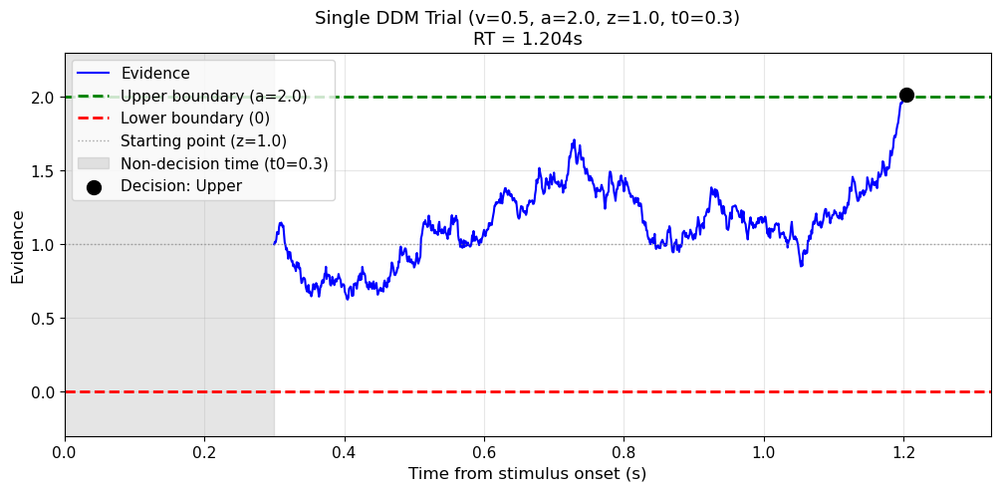

Non-decision time (t0): 0.300s
Decision time: 0.904s
Total RT: 1.204s
Choice: Upper (1)


In [6]:
# Simulate and visualize a single trial
v = 0.5      # Moderate drift toward upper boundary
a = 2.0      # Boundary separation
z = a / 2    # Start in the middle (unbiased)
t0 = 0.3     # Non-decision time

trial = simulate_ddm_trial(v, a, z, t0, seed=42)

# Plot
plt.figure(figsize=(12, 5))

# Plot trajectory
plt.plot(trial['time'], trial['trajectory'], 'b-', linewidth=1.5, label='Evidence')

# Plot boundaries
plt.axhline(y=a, color='green', linestyle='--', linewidth=2, label=f'Upper boundary (a={a})')
plt.axhline(y=0, color='red', linestyle='--', linewidth=2, label='Lower boundary (0)')

# Plot starting point
plt.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.7, label=f'Starting point (z={z})')

# Mark the non-decision time period
plt.axvspan(0, t0, alpha=0.2, color='gray', label=f'Non-decision time (t0={t0})')

# Mark the decision point
choice_label = 'Upper' if trial['choice'] == 1 else 'Lower'
plt.scatter(trial['time'][-1], trial['trajectory'][-1], s=100, c='black', zorder=5, 
            label=f'Decision: {choice_label}')

plt.xlabel('Time from stimulus onset (s)', fontsize=12)
plt.ylabel('Evidence', fontsize=12)
plt.title(f'Single DDM Trial (v={v}, a={a}, z={z}, t0={t0})\nRT = {trial["rt"]:.3f}s', fontsize=13)
plt.legend(loc='upper left')
plt.grid(True, alpha=0.3)
plt.xlim(0, max(trial['time'][-1] * 1.1, 0.5))
plt.ylim(-0.3, a + 0.3)

plt.show()

print(f"Non-decision time (t0): {t0:.3f}s")
print(f"Decision time: {trial['decision_time']:.3f}s")
print(f"Total RT: {trial['rt']:.3f}s")
print(f"Choice: {'Upper (1)' if trial['choice'] == 1 else 'Lower (0)'}")

## Animated Evidence Accumulation

Let's watch evidence accumulation unfold in real time! The animation below shows how the random walk evolves step-by-step until it hits a decision boundary.

In [7]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def create_ddm_animation(v=0.5, a=2.0, z=None, t0=0.3, sigma=1.0, dt=0.001, 
                          speed_factor=50, seed=None):
    """
    Create an animation of DDM evidence accumulation.
    
    Parameters:
    -----------
    v, a, z, t0, sigma, dt : DDM parameters (see simulate_ddm_trial)
    speed_factor : int
        How many time steps to advance per animation frame (higher = faster)
    seed : int
        Random seed for reproducibility
    
    Returns:
    --------
    HTML animation object
    """
    if z is None:
        z = a / 2
    
    # First, simulate the full trial to know the outcome
    trial = simulate_ddm_trial(v, a, z, t0, sigma=sigma, dt=dt, seed=seed)
    trajectory = trial['trajectory']
    times = trial['time']
    
    # Subsample for smoother animation
    n_frames = min(200, len(trajectory) // speed_factor)
    frame_indices = np.linspace(0, len(trajectory) - 1, n_frames).astype(int)
    
    # Set up the figure
    fig, ax = plt.subplots(figsize=(10, 5))
    
    # Plot boundaries
    ax.axhline(y=a, color='green', linestyle='--', linewidth=2, label='Upper boundary')
    ax.axhline(y=0, color='red', linestyle='--', linewidth=2, label='Lower boundary')
    ax.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.7, label=f'Start (z={z})')
    
    # Mark non-decision time period
    ax.axvspan(0, t0, alpha=0.2, color='gray', label=f't0={t0}s')
    
    # Initialize the line and point
    line, = ax.plot([], [], 'b-', linewidth=1.5, label='Evidence')
    point, = ax.plot([], [], 'bo', markersize=8)
    time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=11,
                        verticalalignment='top', fontfamily='monospace')
    
    # Set axis limits
    ax.set_xlim(0, times[-1] * 1.1)
    ax.set_ylim(-0.3, a + 0.3)
    ax.set_xlabel('Time from stimulus onset (s)', fontsize=12)
    ax.set_ylabel('Evidence', fontsize=12)
    ax.set_title(f'DDM Evidence Accumulation (v={v}, a={a})', fontsize=13)
    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3)
    
    def init():
        line.set_data([], [])
        point.set_data([], [])
        time_text.set_text('')
        return line, point, time_text
    
    def animate(frame):
        idx = frame_indices[frame]
        
        # Update line (trajectory so far)
        line.set_data(times[:idx+1], trajectory[:idx+1])
        
        # Update current position point
        point.set_data([times[idx]], [trajectory[idx]])
        
        # Update time display
        current_time = times[idx]
        current_evidence = trajectory[idx]
        time_text.set_text(f'Time: {current_time:.3f}s\nEvidence: {current_evidence:.2f}')
        
        # Check if we've reached a boundary (final frame)
        if frame == n_frames - 1:
            choice = 'Upper (correct)' if trial['choice'] == 1 else 'Lower (error)'
            time_text.set_text(f'Time: {current_time:.3f}s\nEvidence: {current_evidence:.2f}\n'
                              f'Decision: {choice}\nRT: {trial["rt"]:.3f}s')
            point.set_color('green' if trial['choice'] == 1 else 'red')
            point.set_markersize(12)
        
        return line, point, time_text
    
    anim = FuncAnimation(fig, animate, init_func=init, frames=n_frames,
                         interval=50, blit=True, repeat=False)
    
    plt.close(fig)  # Prevent static display
    return HTML(anim.to_jshtml())

# Create and display the animation
print("Watch evidence accumulate toward a decision boundary...")
print("(The animation may take a moment to load)")
create_ddm_animation(v=0.5, a=2.0, t0=0.3, speed_factor=30, seed=42)

Watch evidence accumulate toward a decision boundary...
(The animation may take a moment to load)


In [8]:
# Animation with multiple trials racing simultaneously
def create_racing_trials_animation(v=0.5, a=2.0, z=None, t0=0.3, sigma=1.0, dt=0.001,
                                    n_trials=10, seed=None):
    """
    Animate multiple DDM trials racing toward boundaries simultaneously.
    """
    if z is None:
        z = a / 2
    if seed is not None:
        np.random.seed(seed)
    
    # Simulate all trials first
    trials = [simulate_ddm_trial(v, a, z, t0, sigma=sigma, dt=dt) for _ in range(n_trials)]
    
    # Find the longest trial for x-axis limit
    max_time = max(t['time'][-1] for t in trials)
    
    # Determine number of frames based on longest trial
    n_frames = 150
    time_per_frame = (max_time - t0) / n_frames  # Start animation from t0
    
    # Set up the figure
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Mark non-decision time period
    ax.axvspan(0, t0, alpha=0.2, color='gray', label=f't0={t0}s')
    
    # Plot boundaries
    ax.axhline(y=a, color='green', linestyle='--', linewidth=2.5)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=2.5)
    ax.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.5)
    
    # Initialize lines and points for each trial
    lines = []
    points = []
    colors = plt.cm.Blues(np.linspace(0.4, 0.9, n_trials))
    
    for i in range(n_trials):
        line, = ax.plot([], [], '-', linewidth=1, color=colors[i], alpha=0.7)
        point, = ax.plot([], [], 'o', markersize=6, color=colors[i])
        lines.append(line)
        points.append(point)
    
    # Counter text
    upper_count = ax.text(0.98, 0.95, 'Upper: 0', transform=ax.transAxes, fontsize=12,
                          ha='right', va='top', color='green', fontweight='bold')
    lower_count = ax.text(0.98, 0.88, 'Lower: 0', transform=ax.transAxes, fontsize=12,
                          ha='right', va='top', color='red', fontweight='bold')
    time_text = ax.text(0.02, 0.95, f'Time: {t0:.3f}s', transform=ax.transAxes, fontsize=11,
                        va='top', fontfamily='monospace')
    
    ax.set_xlim(0, max_time * 1.05)
    ax.set_ylim(-0.3, a + 0.3)
    ax.set_xlabel('Time from stimulus onset (s)', fontsize=12)
    ax.set_ylabel('Evidence', fontsize=12)
    ax.set_title(f'{n_trials} DDM Trials Racing (v={v}, a={a})', fontsize=13)
    ax.grid(True, alpha=0.3)
    
    # Track which trials have finished
    finished = [False] * n_trials
    finish_colors = [None] * n_trials
    
    def init():
        for line, point in zip(lines, points):
            line.set_data([], [])
            point.set_data([], [])
        return lines + points + [upper_count, lower_count, time_text]
    
    def animate(frame):
        current_time = t0 + frame * time_per_frame
        n_upper = 0
        n_lower = 0
        
        for i, trial in enumerate(trials):
            # Find index up to current time
            idx = np.searchsorted(trial['time'], current_time)
            idx = min(idx, len(trial['time']) - 1)
            
            # Update line
            lines[i].set_data(trial['time'][:idx+1], trial['trajectory'][:idx+1])
            
            # Check if trial has finished
            if trial['time'][idx] >= trial['time'][-1] - dt:
                if not finished[i]:
                    finished[i] = True
                    finish_colors[i] = 'green' if trial['choice'] == 1 else 'red'
                    lines[i].set_color(finish_colors[i])
                    lines[i].set_alpha(0.8)
                    lines[i].set_linewidth(1.5)
                
                points[i].set_data([trial['time'][-1]], [trial['trajectory'][-1]])
                points[i].set_color(finish_colors[i])
                points[i].set_markersize(10)
            else:
                points[i].set_data([trial['time'][idx]], [trial['trajectory'][idx]])
            
            # Count finished trials
            if finished[i]:
                if trial['choice'] == 1:
                    n_upper += 1
                else:
                    n_lower += 1
        
        upper_count.set_text(f'Upper: {n_upper}')
        lower_count.set_text(f'Lower: {n_lower}')
        time_text.set_text(f'Time: {current_time:.3f}s')
        
        return lines + points + [upper_count, lower_count, time_text]
    
    anim = FuncAnimation(fig, animate, init_func=init, frames=n_frames,
                         interval=50, blit=True, repeat=False)
    
    plt.close(fig)
    return HTML(anim.to_jshtml())

# Show multiple trials racing
print("Watch multiple evidence accumulation processes race toward the boundaries!")
print("(Green = upper boundary, Red = lower boundary)")
create_racing_trials_animation(v=0.5, a=2.0, n_trials=8, seed=123)

Watch multiple evidence accumulation processes race toward the boundaries!
(Green = upper boundary, Red = lower boundary)


In [ ]:
# Try your own parameters! Uncomment and modify:
# create_ddm_animation(v=1.0, a=2.0, seed=None)  # Higher drift - watch it go faster!
# create_ddm_animation(v=0.0, a=2.0, seed=None)  # No drift - pure random walk
# create_ddm_animation(v=0.3, a=1.0, seed=None)  # Narrow boundaries - quick decisions
# create_racing_trials_animation(v=0.0, a=2.0, n_trials=10, seed=None)  # No drift - see 50/50 split

# 2. Multiple Trials: Visualizing Variability

Because of the noise in evidence accumulation, each trial takes a different path — even with identical parameters. Some trials are fast (direct path to boundary), others meander and take longer. Some even reach the "wrong" boundary (errors).

Let's visualize many trials to see this variability.

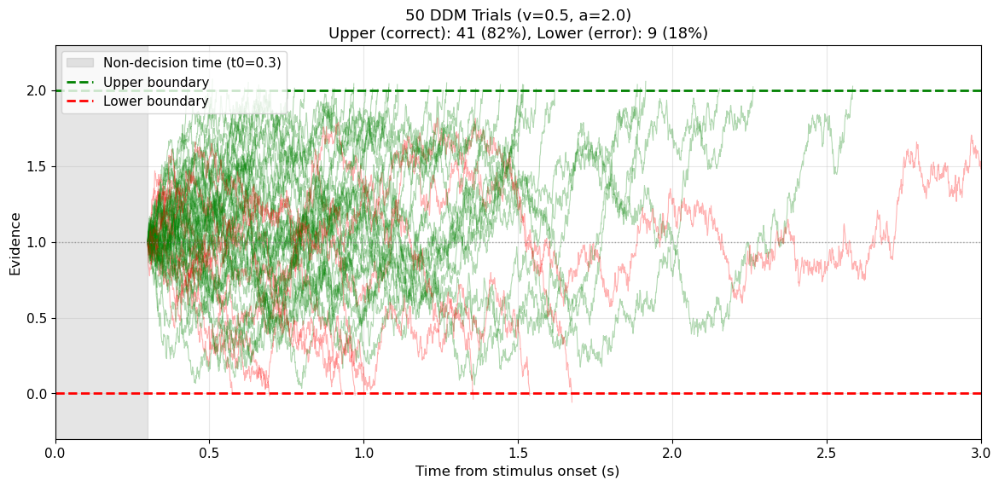

In [9]:
# Simulate multiple trials
n_trials = 50
v = 0.5
a = 2.0
z = a / 2
t0 = 0.3

np.random.seed(123)

plt.figure(figsize=(14, 6))

upper_count = 0
lower_count = 0

for i in range(n_trials):
    trial = simulate_ddm_trial(v, a, z, t0)
    
    # Color by outcome
    if trial['choice'] == 1:
        color = 'green'
        upper_count += 1
    else:
        color = 'red'
        lower_count += 1
    
    plt.plot(trial['time'], trial['trajectory'], color=color, alpha=0.3, linewidth=0.8)

# Mark non-decision time period
plt.axvspan(0, t0, alpha=0.2, color='gray', label=f'Non-decision time (t0={t0})')

# Plot boundaries
plt.axhline(y=a, color='green', linestyle='--', linewidth=2, label=f'Upper boundary')
plt.axhline(y=0, color='red', linestyle='--', linewidth=2, label='Lower boundary')
plt.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.7)

plt.xlabel('Time from stimulus onset (s)', fontsize=12)
plt.ylabel('Evidence', fontsize=12)
plt.title(f'{n_trials} DDM Trials (v={v}, a={a})\n'
          f'Upper (correct): {upper_count} ({100*upper_count/n_trials:.0f}%), '
          f'Lower (error): {lower_count} ({100*lower_count/n_trials:.0f}%)', fontsize=13)
plt.legend(loc='upper left')
plt.grid(True, alpha=0.3)
plt.xlim(0, 3)
plt.ylim(-0.3, a + 0.3)

plt.show()

# 3. Response Time Distributions

A key feature of the DDM is that it predicts the **shape** of RT distributions, not just mean RT. These distributions are typically:
- **Right-skewed**: Most responses are relatively fast, with a long tail of slow responses
- **Different for correct vs. error responses**: Errors are often slower (when drift is toward the correct response)

Let's simulate many trials and look at the RT distributions.

In [10]:
def simulate_ddm_experiment(v, a, z, t0, n_trials=1000, sigma=1.0, dt=0.001):
    """
    Simulate many DDM trials and return summary statistics.
    
    Returns:
    --------
    dict with:
        'choices': array of choices (1=upper, 0=lower)
        'rts': array of response times
        'upper_rts': RTs for upper boundary responses
        'lower_rts': RTs for lower boundary responses
        'accuracy': proportion choosing upper boundary
        'mean_rt': mean RT
    """
    choices = []
    rts = []
    
    for _ in range(n_trials):
        trial = simulate_ddm_trial(v, a, z, t0, sigma=sigma, dt=dt)
        if trial['choice'] != -1:  # Exclude timeouts
            choices.append(trial['choice'])
            rts.append(trial['rt'])
    
    choices = np.array(choices)
    rts = np.array(rts)
    
    return {
        'choices': choices,
        'rts': rts,
        'upper_rts': rts[choices == 1],
        'lower_rts': rts[choices == 0],
        'accuracy': np.mean(choices),
        'mean_rt': np.mean(rts),
        'mean_rt_upper': np.mean(rts[choices == 1]) if np.sum(choices == 1) > 0 else np.nan,
        'mean_rt_lower': np.mean(rts[choices == 0]) if np.sum(choices == 0) > 0 else np.nan
    }

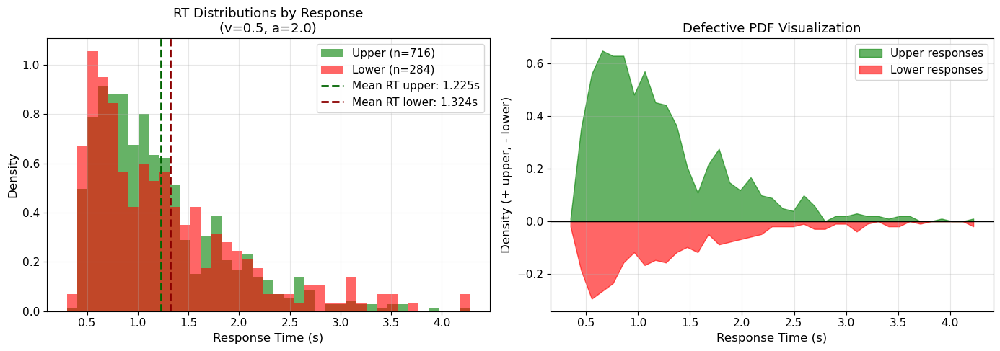

Accuracy (prop. upper): 0.716
Mean RT: 1.253s
Mean RT (upper): 1.225s
Mean RT (lower): 1.324s


In [11]:
# Simulate experiment
v = 0.5
a = 2.0  
z = a / 2
t0 = 0.3
n_trials = 1000

np.random.seed(42)
results = simulate_ddm_experiment(v, a, z, t0, n_trials=n_trials)

# Plot RT distributions
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Left: Histogram of all RTs
ax = axes[0]
bins = np.linspace(t0, np.percentile(results['rts'], 99), 40)
ax.hist(results['upper_rts'], bins=bins, alpha=0.6, color='green', 
        label=f'Upper (n={len(results["upper_rts"])})', density=True)
ax.hist(results['lower_rts'], bins=bins, alpha=0.6, color='red', 
        label=f'Lower (n={len(results["lower_rts"])})', density=True)
ax.axvline(x=results['mean_rt_upper'], color='darkgreen', linestyle='--', 
           linewidth=2, label=f'Mean RT upper: {results["mean_rt_upper"]:.3f}s')
ax.axvline(x=results['mean_rt_lower'], color='darkred', linestyle='--', 
           linewidth=2, label=f'Mean RT lower: {results["mean_rt_lower"]:.3f}s')
ax.set_xlabel('Response Time (s)', fontsize=12)
ax.set_ylabel('Density', fontsize=12)
ax.set_title(f'RT Distributions by Response\n(v={v}, a={a})', fontsize=13)
ax.legend(loc='upper right')
ax.grid(True, alpha=0.3)

# Right: Defective PDF style (showing both distributions with sign)
ax = axes[1]
bins = np.linspace(t0, np.percentile(results['rts'], 99), 40)

# Upper boundary responses (positive)
counts_upper, edges = np.histogram(results['upper_rts'], bins=bins, density=False)
counts_upper = counts_upper / n_trials / (bins[1] - bins[0])  # Normalize by total trials

# Lower boundary responses (negative, for visualization)
counts_lower, _ = np.histogram(results['lower_rts'], bins=bins, density=False)
counts_lower = counts_lower / n_trials / (bins[1] - bins[0])

bin_centers = (edges[:-1] + edges[1:]) / 2
ax.fill_between(bin_centers, 0, counts_upper, alpha=0.6, color='green', label='Upper responses')
ax.fill_between(bin_centers, 0, -counts_lower, alpha=0.6, color='red', label='Lower responses')
ax.axhline(y=0, color='black', linewidth=1)
ax.set_xlabel('Response Time (s)', fontsize=12)
ax.set_ylabel('Density (+ upper, - lower)', fontsize=12)
ax.set_title('Defective PDF Visualization', fontsize=13)
ax.legend(loc='upper right')
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print(f"Accuracy (prop. upper): {results['accuracy']:.3f}")
print(f"Mean RT: {results['mean_rt']:.3f}s")
print(f"Mean RT (upper): {results['mean_rt_upper']:.3f}s")
print(f"Mean RT (lower): {results['mean_rt_lower']:.3f}s")

# 4. How Parameters Affect Behavior

Now let's systematically explore how each DDM parameter affects accuracy and RT distributions.

## 4.1 Drift Rate (v)

The drift rate reflects the quality of evidence or task difficulty:
- **Higher |v|** = easier task = faster and more accurate
- **v = 0** = no evidence = random guessing, slow responses
- **Sign of v** = which response is correct

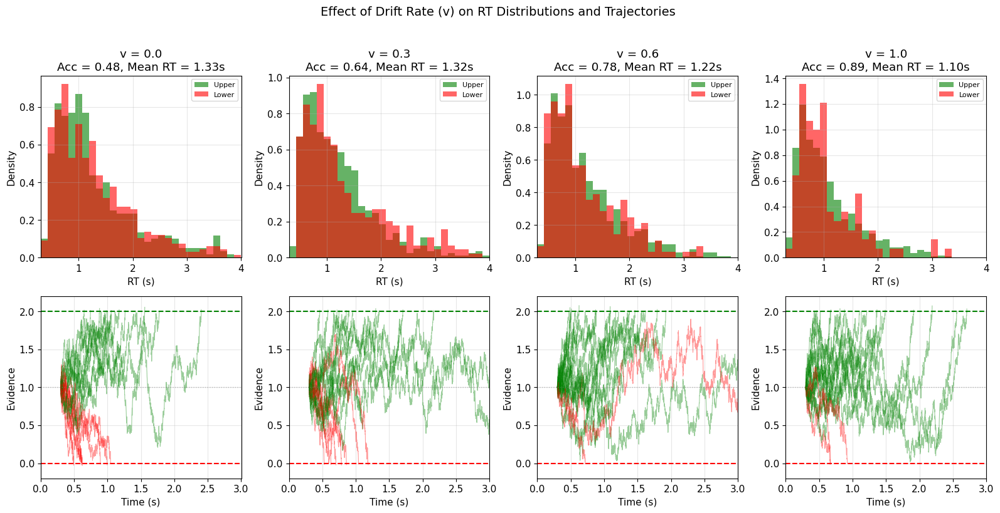

In [12]:
# Effect of drift rate
drift_rates = [0.0, 0.3, 0.6, 1.0]
a = 2.0
z = a / 2
t0 = 0.3
n_trials = 1000

fig, axes = plt.subplots(2, 4, figsize=(16, 8))

np.random.seed(42)

for i, v in enumerate(drift_rates):
    results = simulate_ddm_experiment(v, a, z, t0, n_trials=n_trials)
    
    # Top row: RT distributions
    ax = axes[0, i]
    bins = np.linspace(t0, 4, 30)
    if len(results['upper_rts']) > 0:
        ax.hist(results['upper_rts'], bins=bins, alpha=0.6, color='green', density=True, label='Upper')
    if len(results['lower_rts']) > 0:
        ax.hist(results['lower_rts'], bins=bins, alpha=0.6, color='red', density=True, label='Lower')
    ax.set_xlabel('RT (s)')
    ax.set_ylabel('Density')
    ax.set_title(f'v = {v}\nAcc = {results["accuracy"]:.2f}, Mean RT = {results["mean_rt"]:.2f}s')
    ax.legend(loc='upper right', fontsize=8)
    ax.set_xlim(t0, 4)
    ax.grid(True, alpha=0.3)
    
    # Bottom row: Sample trajectories
    ax = axes[1, i]
    for j in range(20):
        trial = simulate_ddm_trial(v, a, z, t0)
        color = 'green' if trial['choice'] == 1 else 'red'
        ax.plot(trial['time'], trial['trajectory'], color=color, alpha=0.4, linewidth=0.8)
    ax.axhline(y=a, color='green', linestyle='--', linewidth=1.5)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5)
    ax.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.5)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Evidence')
    ax.set_xlim(0, 3)
    ax.set_ylim(-0.2, a + 0.2)
    ax.grid(True, alpha=0.3)

plt.suptitle('Effect of Drift Rate (v) on RT Distributions and Trajectories', fontsize=14, y=1.02)
plt.tight_layout()
plt.show()

## 4.2 Boundary Separation (a)

Boundary separation reflects the **speed-accuracy tradeoff**:
- **Wider boundaries (larger a)** = need more evidence = slower but more accurate
- **Narrower boundaries (smaller a)** = less evidence needed = faster but less accurate

This is under strategic control — you can decide to be more careful or more impulsive.

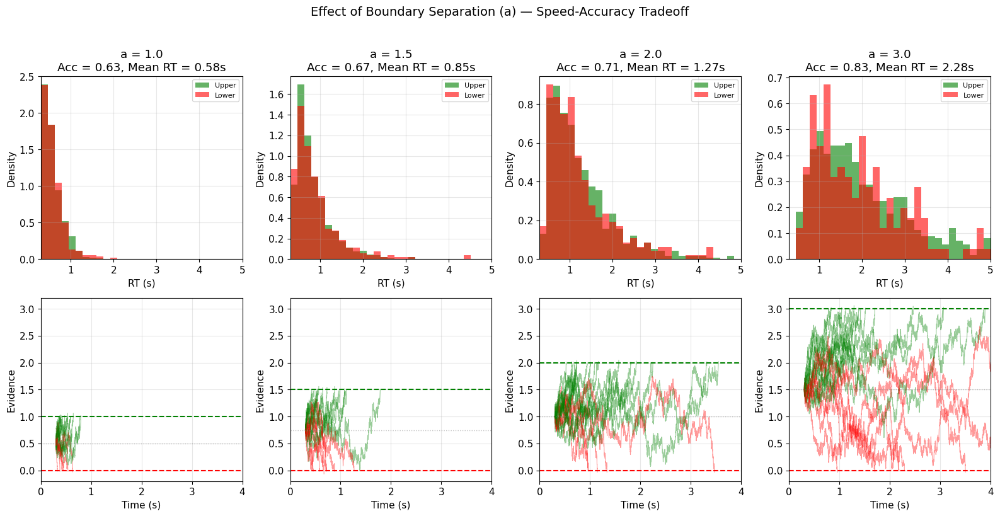

In [13]:
# Effect of boundary separation
boundaries = [1.0, 1.5, 2.0, 3.0]
v = 0.5
t0 = 0.3
n_trials = 1000

fig, axes = plt.subplots(2, 4, figsize=(16, 8))

np.random.seed(42)

for i, a in enumerate(boundaries):
    z = a / 2  # Unbiased starting point
    results = simulate_ddm_experiment(v, a, z, t0, n_trials=n_trials)
    
    # Top row: RT distributions
    ax = axes[0, i]
    bins = np.linspace(t0, 5, 30)
    if len(results['upper_rts']) > 0:
        ax.hist(results['upper_rts'], bins=bins, alpha=0.6, color='green', density=True, label='Upper')
    if len(results['lower_rts']) > 0:
        ax.hist(results['lower_rts'], bins=bins, alpha=0.6, color='red', density=True, label='Lower')
    ax.set_xlabel('RT (s)')
    ax.set_ylabel('Density')
    ax.set_title(f'a = {a}\nAcc = {results["accuracy"]:.2f}, Mean RT = {results["mean_rt"]:.2f}s')
    ax.legend(loc='upper right', fontsize=8)
    ax.set_xlim(t0, 5)
    ax.grid(True, alpha=0.3)
    
    # Bottom row: Sample trajectories (scaled to same visual height)
    ax = axes[1, i]
    for j in range(20):
        trial = simulate_ddm_trial(v, a, z, t0)
        color = 'green' if trial['choice'] == 1 else 'red'
        ax.plot(trial['time'], trial['trajectory'], color=color, alpha=0.4, linewidth=0.8)
    ax.axhline(y=a, color='green', linestyle='--', linewidth=1.5)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5)
    ax.axhline(y=z, color='gray', linestyle=':', linewidth=1, alpha=0.5)
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Evidence')
    ax.set_xlim(0, 4)
    ax.set_ylim(-0.2, 3.2)
    ax.grid(True, alpha=0.3)

plt.suptitle('Effect of Boundary Separation (a) — Speed-Accuracy Tradeoff', fontsize=14, y=1.02)
plt.tight_layout()
plt.show()

## 4.3 Starting Point (z)

The starting point reflects **response bias**:
- **z = a/2**: No bias, start equidistant from both boundaries
- **z > a/2**: Biased toward upper boundary (more likely to choose upper, faster upper responses)
- **z < a/2**: Biased toward lower boundary

This is analogous to criterion in Signal Detection Theory.

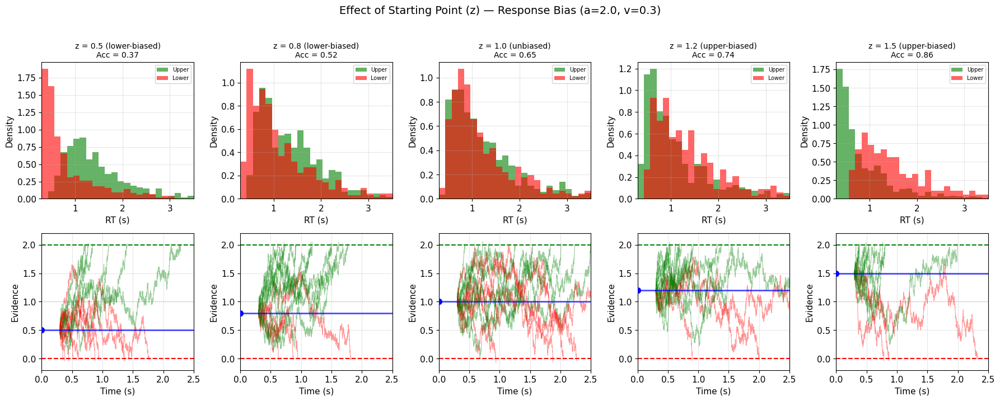

In [14]:
# Effect of starting point
a = 2.0
starting_points = [0.5, 0.8, 1.0, 1.2, 1.5]  # From biased-lower to biased-upper
v = 0.3  # Moderate drift
t0 = 0.3
n_trials = 1000

fig, axes = plt.subplots(2, 5, figsize=(18, 7))

np.random.seed(42)

for i, z in enumerate(starting_points):
    results = simulate_ddm_experiment(v, a, z, t0, n_trials=n_trials)
    
    bias_label = 'lower-biased' if z < a/2 else ('unbiased' if z == a/2 else 'upper-biased')
    
    # Top row: RT distributions
    ax = axes[0, i]
    bins = np.linspace(t0, 3.5, 25)
    if len(results['upper_rts']) > 0:
        ax.hist(results['upper_rts'], bins=bins, alpha=0.6, color='green', density=True, label='Upper')
    if len(results['lower_rts']) > 0:
        ax.hist(results['lower_rts'], bins=bins, alpha=0.6, color='red', density=True, label='Lower')
    ax.set_xlabel('RT (s)')
    ax.set_ylabel('Density')
    ax.set_title(f'z = {z} ({bias_label})\nAcc = {results["accuracy"]:.2f}', fontsize=10)
    ax.legend(loc='upper right', fontsize=7)
    ax.set_xlim(t0, 3.5)
    ax.grid(True, alpha=0.3)
    
    # Bottom row: Sample trajectories
    ax = axes[1, i]
    for j in range(15):
        trial = simulate_ddm_trial(v, a, z, t0)
        color = 'green' if trial['choice'] == 1 else 'red'
        ax.plot(trial['time'], trial['trajectory'], color=color, alpha=0.4, linewidth=0.8)
    ax.axhline(y=a, color='green', linestyle='--', linewidth=1.5)
    ax.axhline(y=0, color='red', linestyle='--', linewidth=1.5)
    ax.axhline(y=z, color='blue', linestyle='-', linewidth=2, alpha=0.7)
    ax.axhline(y=a/2, color='gray', linestyle=':', linewidth=1, alpha=0.5)
    ax.scatter(0, z, s=50, c='blue', zorder=5)  # Mark starting point
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Evidence')
    ax.set_xlim(0, 2.5)
    ax.set_ylim(-0.2, a + 0.2)
    ax.grid(True, alpha=0.3)

plt.suptitle(f'Effect of Starting Point (z) — Response Bias (a={a}, v={v})', fontsize=14, y=1.02)
plt.tight_layout()
plt.show()

<div class="alert alert-success">

# 5. Exercise 1: Summarizing Parameter Effects

In sections 4.1-4.3, you saw how each parameter affects behavior individually. Now it's time to create summary visualizations that show these relationships more systematically.

**Your task**: Create a figure with 2 rows × 3 columns of subplots showing:

**Column 1 - Drift Rate (v):**
- Top: Accuracy vs drift rate (v from 0 to 1.5, a = 2.0, z = a/2, t0 = 0.3)
- Bottom: Mean RT vs drift rate

**Column 2 - Boundary Separation (a):**
- Top: Accuracy vs boundary (a from 1.0 to 3.5, v = 0.5, z = a/2, t0 = 0.3)
- Bottom: Mean RT vs boundary

**Column 3 - Starting Point (z):**
- Top: Accuracy (prop. upper) vs starting point (z from 0.4 to 1.6, v = 0.5, a = 2.0, t0 = 0.3)
- Bottom: Mean RT for upper vs lower responses separately

Use the `simulate_ddm_experiment` function to run simulations for each parameter value. Use at least 500 trials per condition for stable estimates.

In [ ]:
# YOUR CODE - Exercise: Summarizing Parameter Effects

<div class="alert alert-success">

### YOUR NOTES - Exercise 1: Summarizing Parameter Effects

Based on your plots, answer the following:

1. Which parameter has the strongest effect on accuracy? On RT?

2. For drift rate and boundary separation: do accuracy and RT move in the same direction or opposite directions as you increase the parameter?

3. What is unique about the starting point's effect on RT? (Hint: look at upper vs lower responses separately)

<div class="alert alert-success">

# 6. Exercise 2: Explore Parameter Interactions

**Your task**: Modify the code above to explore how parameters interact.

1. What happens when you have **high drift rate + narrow boundaries** vs **low drift rate + wide boundaries**? Can you achieve similar accuracy with very different mean RTs?

2. If the "correct" response is the upper boundary (v > 0), how does starting point bias affect the error rate and the RT for errors vs correct responses?

3. Create a plot showing the **speed-accuracy tradeoff curve**: vary boundary separation and plot accuracy vs mean RT. What shape does this curve have?

Tips: 
- Create new cells for each exploration so you can compare results
- Add titles to your plots that indicate the parameter values you're testing
- Consider writing a helper function to run multiple simulations

In [ ]:
# YOUR CODE - Exercise 2

### YOUR NOTES - Exercise 2

<div class="alert alert-success">

# 7. Exercise 3: Non-Decision Time

Non-decision time ($t_0$) represents the time for:
- Stimulus encoding (perceiving the stimulus)
- Motor response execution (pressing a button)

**Your task**: 

1. Vary $t_0$ from 0.1 to 0.5 seconds (v = 0.5, a = 2.0, z = a/2). How does this affect the RT distribution? Does it affect accuracy?

2. Non-decision time shifts the entire RT distribution. Verify this by plotting RT distributions for different $t_0$ values on the same axes.

3. In a real experiment, why might it be important to separately estimate $t_0$ vs the decision-related parameters?

Note: The code for simulating experiments with different parameters is available in sections 4 and 5 above.

### YOUR NOTES - Exercise 3

<div class="alert alert-success">

# 8. (OPTIONAL) Exercise 4: Connecting DDM to SDT

The DDM and Signal Detection Theory are related:
- DDM's **drift rate** is analogous to SDT's **d'** (sensitivity)
- DDM's **starting point bias** is analogous to SDT's **criterion**

**Your task**:

1. **Fitting SDT to DDM behavior**: Write a function that simulates a dot motion discrimination task using DDM. Assume the drift is positive (+v) when dots move right and negative (-v) when dots move left. The "correct" response is upper boundary for rightward motion, lower boundary for leftward motion. Your function should:
   - Take DDM parameters (v, a, z, t0) and number of trials per direction
   - Simulate the experiment (equal trials of each motion direction)
   - Compute hit rate and false alarm rate from the choices
   - Return estimated d' and criterion using the SDT formulas from PS2
    
2. For a fixed boundary separation, show that higher drift rates lead to higher estimated d' (with accuracy approaching ceiling for very high drift).

3. Show that starting point bias affects the proportion of "rightward" responses (like criterion in SDT), but also affects RTs — something SDT doesn't capture.

4. What additional information does DDM provide that SDT cannot? What are the advantages of modeling RTs?

Hint: Think about what you learned in PS2 about the relationship between d', criterion, hit rate, and false alarm rate.

### YOUR NOTES - Exercise 4

# 9. Summary

The Drift Diffusion Model provides a powerful framework for understanding speeded decisions:

| Parameter | What it represents | Effect on behavior |
|-----------|-------------------|--------------------|
| **Drift rate (v)** | Evidence quality / task difficulty | Higher = faster + more accurate |
| **Boundary separation (a)** | Response caution | Higher = slower + more accurate |
| **Starting point (z)** | Response bias | Closer to boundary = faster + more likely |
| **Non-decision time (t0)** | Encoding + motor time | Shifts RT distribution |

Key insights:
1. **RT distributions are right-skewed** — most responses fast, some slow
2. **Speed-accuracy tradeoff** is controlled by boundary separation
3. **Errors are often slower** than correct responses (when drift favors correct)
4. **DDM extends SDT** by explaining when decisions occur, not just what decisions are made

## Connection to SDT (PS2)
- Drift rate (v) ↔ Sensitivity (d'): Both reflect discriminability
- Starting point (z) ↔ Criterion (c): Both reflect response bias
- DDM adds: RT predictions, speed-accuracy tradeoff, error RT patterns